In [1]:
import pandas as pd
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
import nltk
import numpy as np
from wordcloud import WordCloud
from textblob import TextBlob
import re

In [2]:
import dill
#dill.load_session('notebook_env.db')

In [3]:
df = pd.read_csv('Data/l1_detailed_listings.csv', encoding = "UTF-8")
df=df.drop("status", axis=1)
#df=df.drop("id", axis=1)


In [4]:
df['description'] = df['description'].fillna("")

# Convert all the string to lower cases
df['description'] = df['description'].str.lower()
# \S+ means anything that is not an empty space
#df['selftext'] = df['description'].apply(lambda x: re.sub('http\S*', '', x))
# \s+ means all empty space (\n, \r, \t)
df['description'] = df['description'].apply(lambda x: re.sub('\s+', ' ', x))

corpus = ' '.join(df['description'])
corpus = corpus.lower()



In [5]:
from nltk.probability import FreqDist
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string

In [6]:
lemmatizer= WordNetLemmatizer()


In [7]:
stop_filters = stopwords.words('english') + list(string.punctuation)

# Whole Dataset

In [8]:
def extra_filter(corpus, stop_tokens):
    '''

corpus: string format of text data
    stop_tokens: list of tokens you wish to add to stopwords filter
    '''
    from nltk.tokenize import word_tokenize
    
    stop_filters = stopwords.words('english') + list(string.punctuation) + stop_tokens
    filtered_tokens = [lemmatizer.lemmatize(tokens) for tokens in word_tokenize(corpus) 
                       if tokens not in stop_filters]
    return filtered_tokens

In [9]:
extra_stopwords = ['...', 'This', 'A', 'The', 'âœ', 'â€¢']

toks = extra_filter(corpus= corpus, stop_tokens=extra_stopwords)

In [10]:
fdist = FreqDist(toks)
fdist.most_common(50)

[('city', 4841),
 ('street', 3410),
 ('apartment', 3152),
 ('center', 3016),
 ('philadelphia', 2923),
 ('guest', 2670),
 ('parking', 2582),
 ('neighborhood', 2337),
 ('block', 2334),
 ('minute', 2323),
 ('walk', 2305),
 ('home', 2279),
 ('bedroom', 2222),
 ('’', 2169),
 ("'s", 2132),
 ('away', 1979),
 ('kitchen', 1964),
 ('bed', 1951),
 ('area', 1949),
 ('house', 1892),
 ('also', 1879),
 ('floor', 1874),
 ('restaurant', 1804),
 ('room', 1774),
 ('space', 1738),
 ('one', 1723),
 ('located', 1705),
 ('stay', 1703),
 ('access', 1619),
 ('please', 1619),
 ('available', 1587),
 ('2', 1559),
 ('full', 1352),
 ('need', 1348),
 ('building', 1336),
 ('bathroom', 1324),
 ('free', 1311),
 ('park', 1283),
 ('living', 1265),
 ('•', 1245),
 ('philly', 1236),
 ('bus', 1157),
 ('min', 1151),
 ('tv', 1140),
 ('private', 1130),
 ('two', 1126),
 ('great', 1125),
 ('walking', 1090),
 ('coffee', 1087),
 ('place', 1069)]

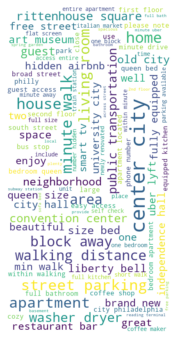

In [11]:
wc = WordCloud(background_color="white", 
               max_words=100, 
               width=400, 
               height=800,
               collocations = True,
               #collocation_threshold = 1
              ).generate(' '.join(toks))
import matplotlib.pyplot as plt
%matplotlib inline
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()
wc.to_file('static/main.png')

In [12]:
fdist.keys()

dict_keys(['northern', 'liberty', 'philadelphia', '-2058', 'sq', 'ft', 'home', '3', 'bedroom', 'large', 'deck', 'table-seats', '6-8', 'grill', 'available', 'wonderful', 'jacuzzi', 'bath', 'tub', 'dining', 'room', 'seat', '8.', 'free', 'wifi', 'house', 'satellite', 'radio', '20', 'minute', 'walk', 'independence', 'hall', 'center', 'city', 'driveway', 'parking-2', 'car', 'additional', 'street', 'parking', 'uber', '8', 'great', 'funky', 'eclectic', 'neighborhood', 'hip', 'bowling', 'alley', 'quaint', 'restaurant', 'bar', 'fishtown', 'adjacent', 'spot', 'outdoor', 'space', 'spring', 'fall', 'provides', 'area', 'seating', 'comfort', 'serenity', 'laugh', 'relax', 'indoor', 'lot', 'common', 'mingle', 'kitchen', 'spread', 'eat', 'access', 'entire', '5', 'block', 'fishtown-', 'fillmore', 'concert', 'venue', 'electric', 'factory', 'delaware', 'river', 'waterfront/sugar', 'casino/festival', 'pier', '3-5', 'piazza', 'shop', 'gallery', 'grocery', 'store', 'playground-beautiful', 'park', '-3', 'away

In [13]:
fdist['keurig']

48

In [14]:
fdist.hapaxes()

['-2058',
 'table-seats',
 'parking-2',
 'waterfront/sugar',
 'casino/festival',
 'playground-beautiful',
 'playground/park',
 'ajacent',
 'bask',
 'btw',
 'snuggle',
 'comfiest',
 'nightie-night',
 'beware',
 'rattle',
 'burbs',
 'supremely',
 'aboard',
 'reopen',
 'whole-floor',
 'warmly',
 '400+',
 'west-facing',
 'width',
 'living-room',
 'blond',
 'tropical',
 'houseplant',
 '40/night',
 'off/leave',
 'chem-free',
 'inclusion',
 'discrimination',
 '★this',
 'puzzle',
 'creepiest',
 'whiz',
 'onion',
 'peanut',
 'butter-vanilla',
 'brewerytown/art',
 'straight-through',
 'antenna',
 '-middle',
 'kettle/spices/salt/pepper/sugar/coffee/toaster/tea',
 '-china',
 'bench/tables',
 'laundromate',
 '12-14',
 'ways-',
 'lr/dr/den',
 'unesco',
 'cite',
 'doubling',
 'ping-pong',
 'resembles',
 '~recent',
 'tv/dvd',
 'birdwatch',
 'directtv',
 '//www.airbnb.com/rooms/7678587',
 'checkin=01',
 '2f29',
 'checkout=01',
 '2f31',
 's=rwjke1ox',
 'airport/main',
 'ains',
 'kurig',
 'timeworn',
 's

In [15]:
rev_bigram = list(nltk.bigrams(rev_new_toks))

NameError: name 'rev_new_toks' is not defined

In [16]:
fdist_bi = FreqDist(rev_bigram)
fdist_bi.most_common(50)

NameError: name 'rev_bigram' is not defined

In [17]:
df_nlp = df
sample_size = 10000

def sentiment_func(x):
    sentiment = TextBlob(x['description'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

sample = df_nlp.apply(sentiment_func, axis=1)

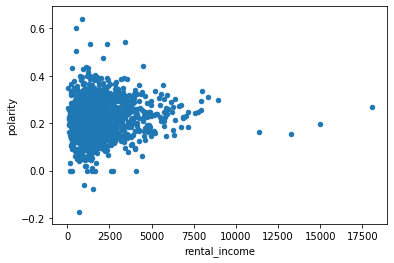

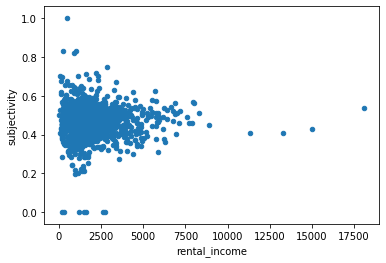

In [18]:
sample.plot.scatter('rental_income', 'polarity')
sample.plot.scatter('rental_income', 'subjectivity')


# Individual Amenities

In [19]:
am_df = df[df['description'].str.contains('dishwasher', na=False)]
no_am_df = df[df['description'].str.contains('dishwasher', na=False)==False]

In [20]:
am_names=pd.read_csv('Data/l0_amenities.csv')

In [21]:
am_names = am_names.columns

In [22]:
from sklearn.feature_extraction.text import CountVectorizer
count_vec = CountVectorizer(ngram_range=(1,10), min_df=2)

24-hour check-in


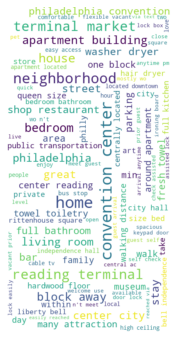

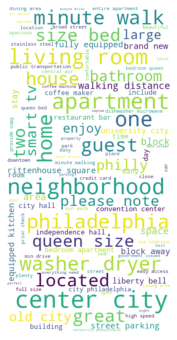

Accessible-height bed


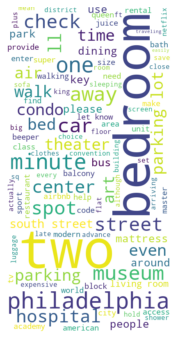

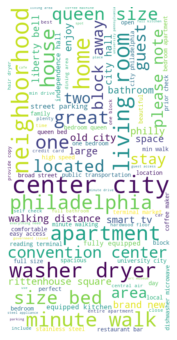

Accessible-height toilet


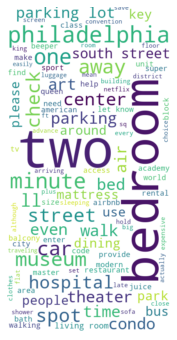

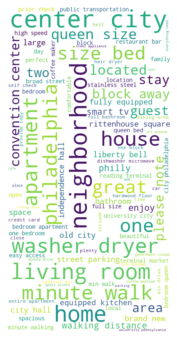

Air conditioning


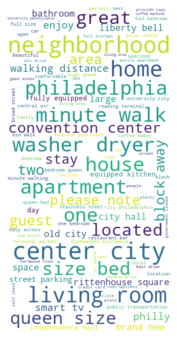

Not Available
Amazon Echo
Not Available
BBQ grill


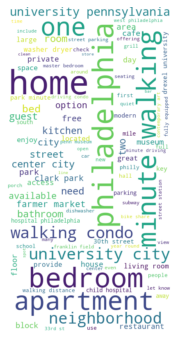

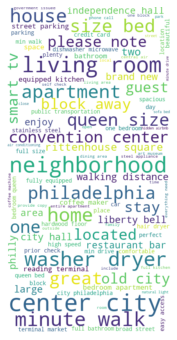

Baby bath


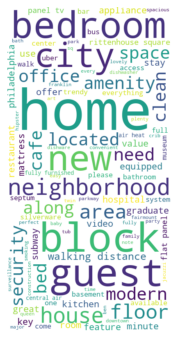

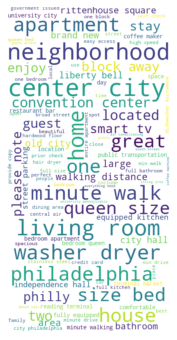

Baby monitor
Not Available
Babysitter recommendations


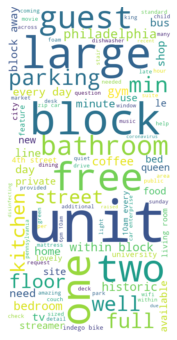

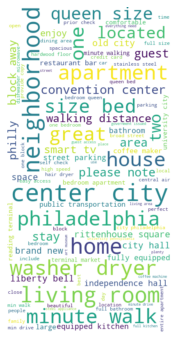

Baking sheet


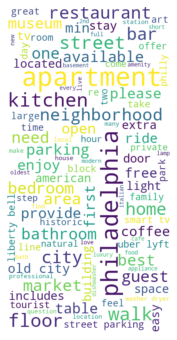

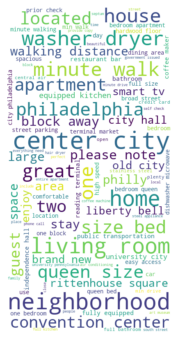

Balcony
Not Available
Barbecue utensils


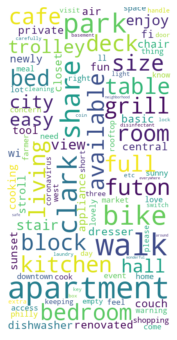

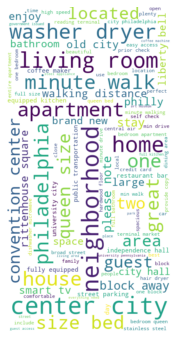

Bath towel


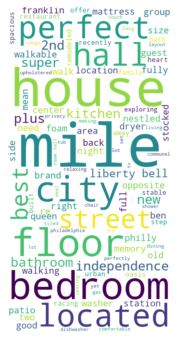

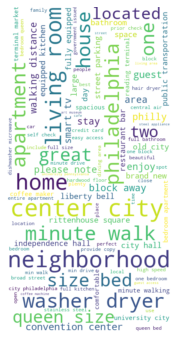

Bathroom essentials


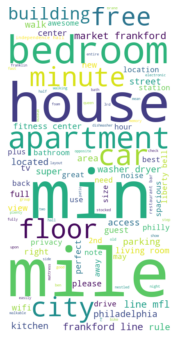

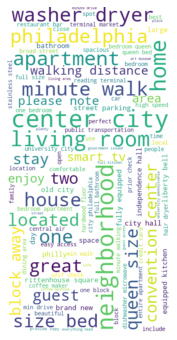

Bathtub


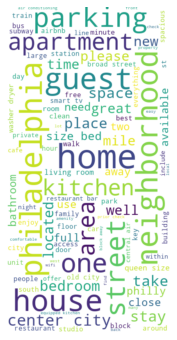

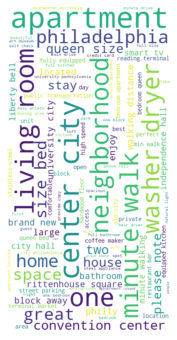

Beach essentials
Not Available
Bed linens


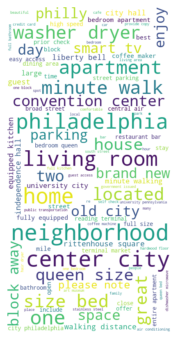

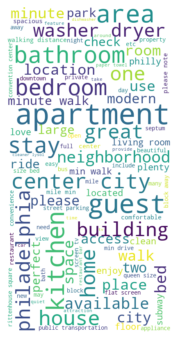

Bedroom comforts


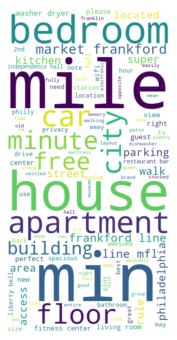

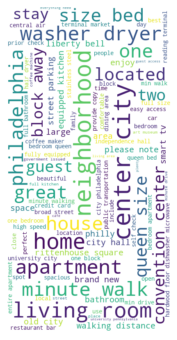

Body soap


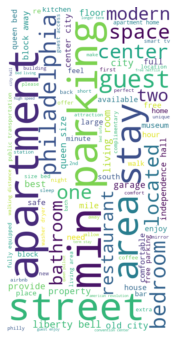

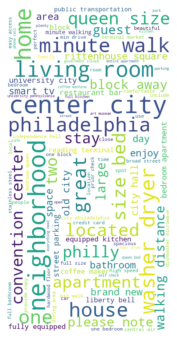

Bread maker


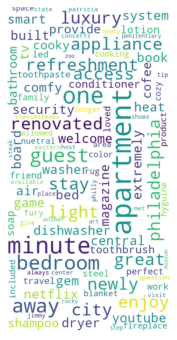

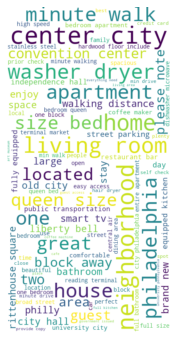

Breakfast


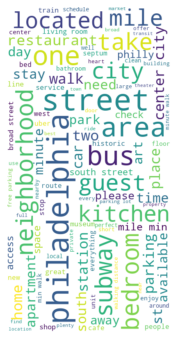

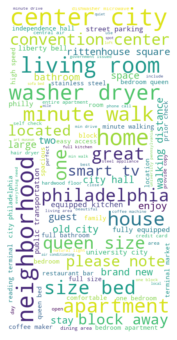

Breakfast table
Not Available
Building staff


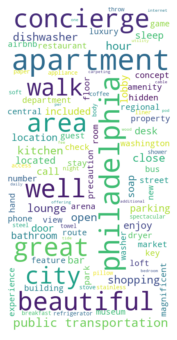

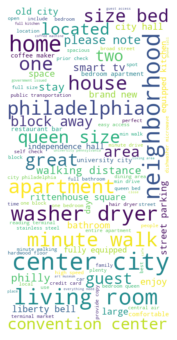

Buzzer/wireless intercom


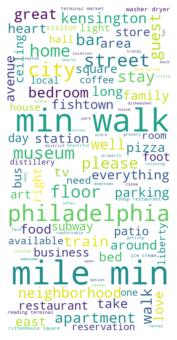

Not Available
Cable TV


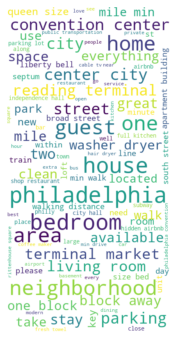

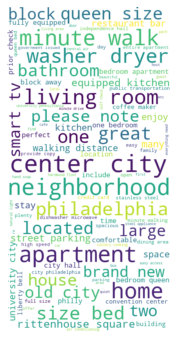

Carbon monoxide alarm


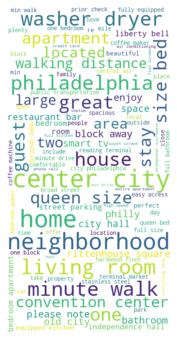

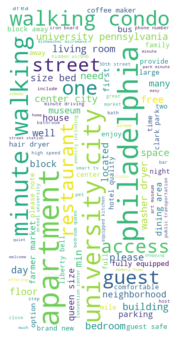

Carbon monoxide detector


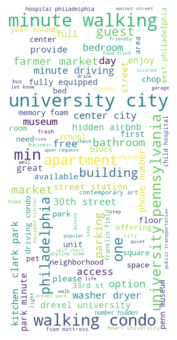

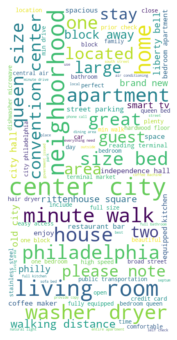

Cat(s)


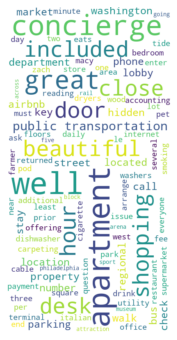

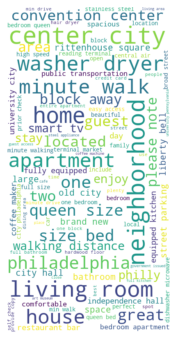

Ceiling fan


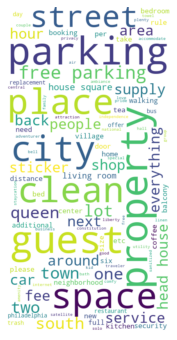

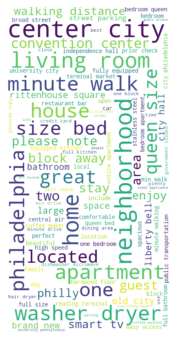

Central air conditioning
Not Available
Changing table


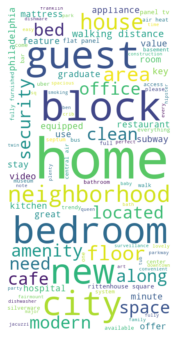

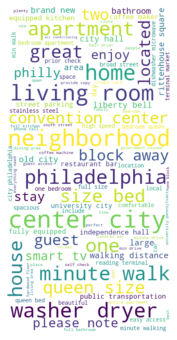

Children’s books and toys


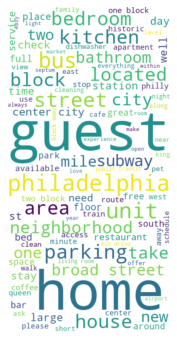

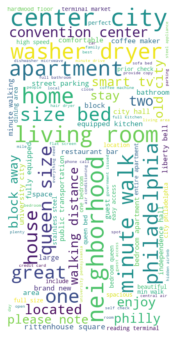

Children’s dinnerware


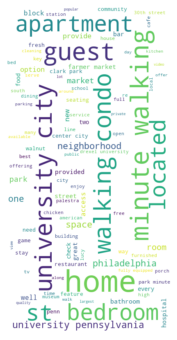

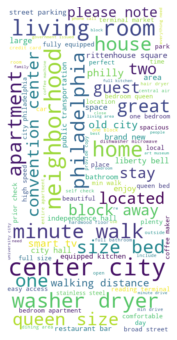

Cleaning before checkout


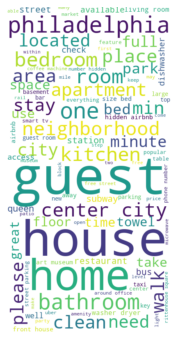

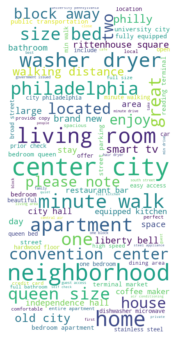

Coffee maker


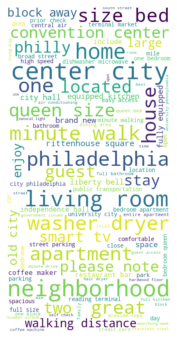

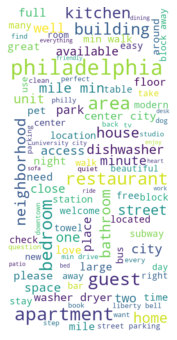

Conditioner


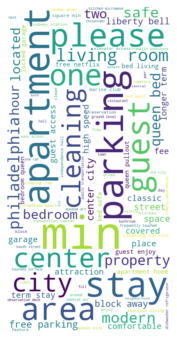

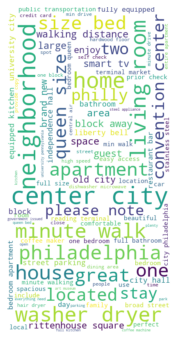

Convection oven
Not Available
Cooking basics


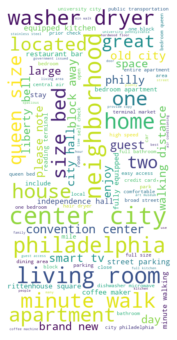

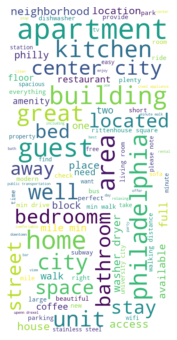

Crib


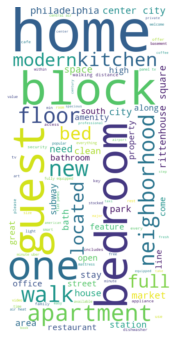

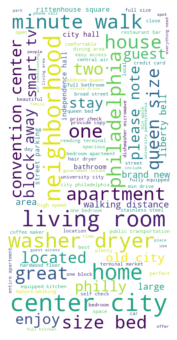

DVD player
Not Available
Day bed
Not Available
Disabled parking spot
Not Available
Dishes and silverware


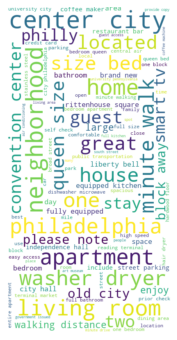

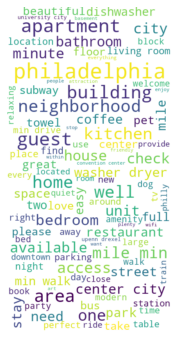

Dishwasher


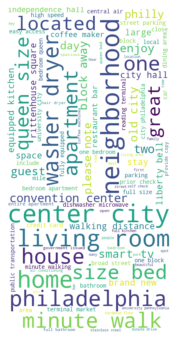

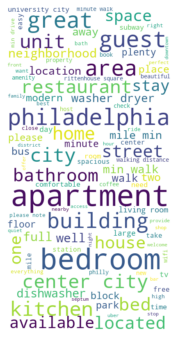

Dog(s)


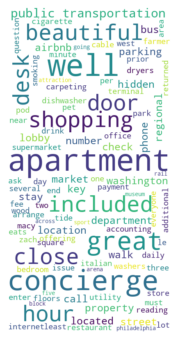

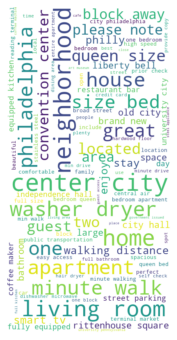

Dryer


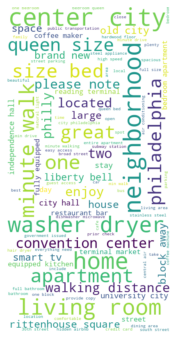

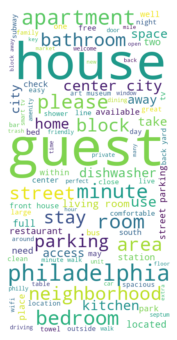

EV charger
Not Available
Elevator


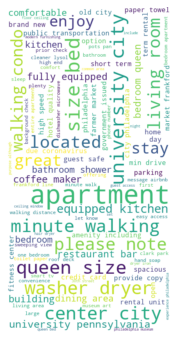

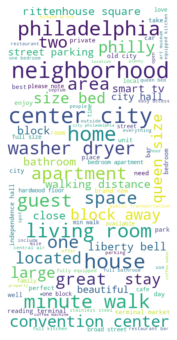

En suite bathroom
Not Available
Espresso machine
Not Available
Essentials


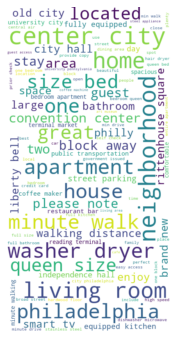

Not Available
Ethernet connection


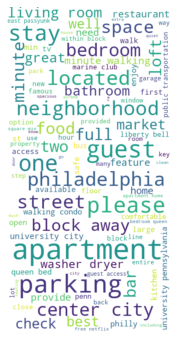

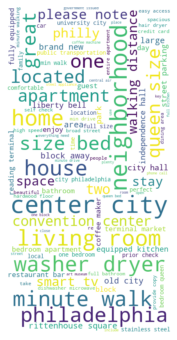

Extra pillows and blankets


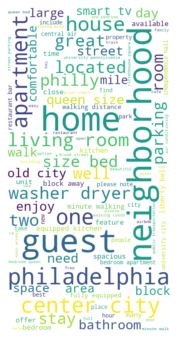

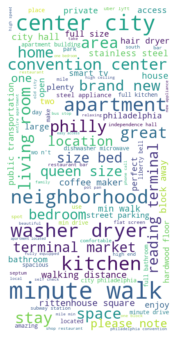

Extra space around bed


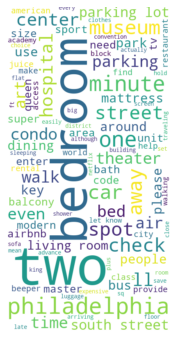

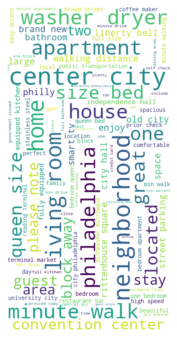

Family/kid friendly


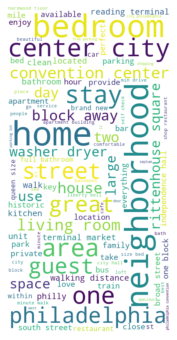

Not Available
Fire extinguisher


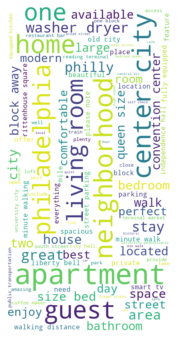

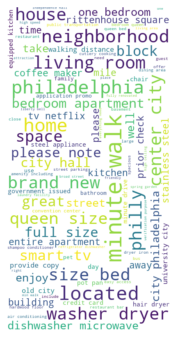

Fire pit
Not Available
Fireplace guards


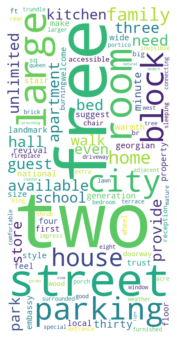

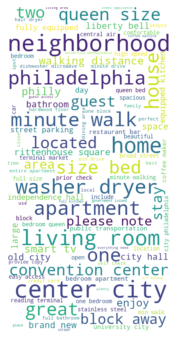

Firm mattress
Not Available
First aid kit


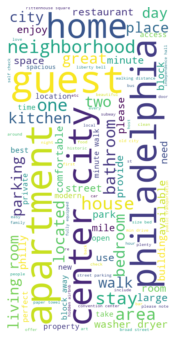

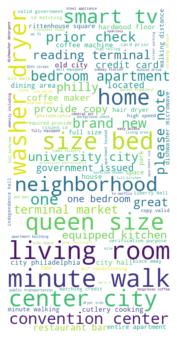

Fixed grab bars for shower


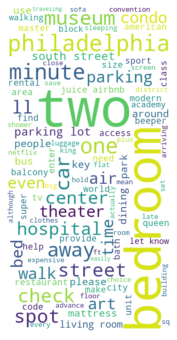

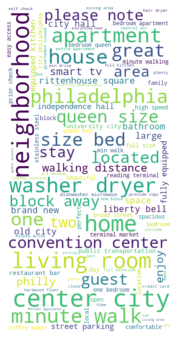

Flat path to guest entrance


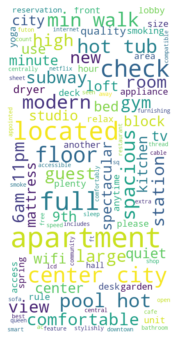

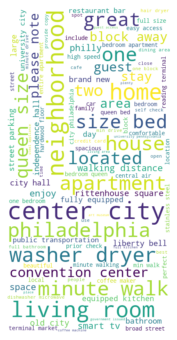

Formal dining area
Not Available
Free parking on premises


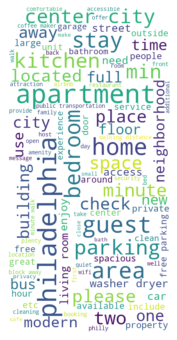

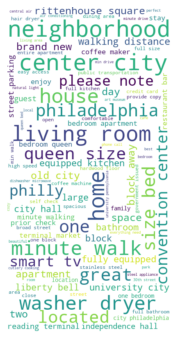

Free street parking


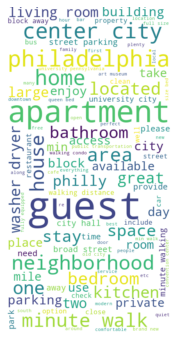

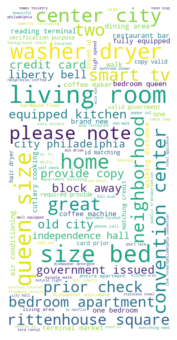

Freezer


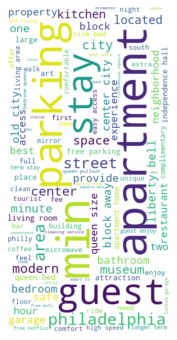

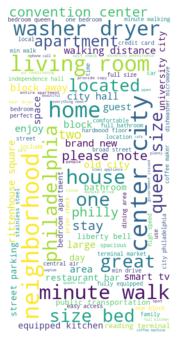

Full kitchen


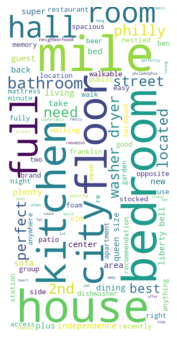

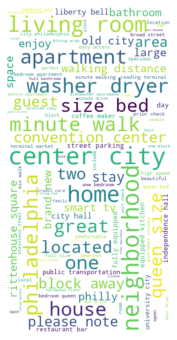

Game console


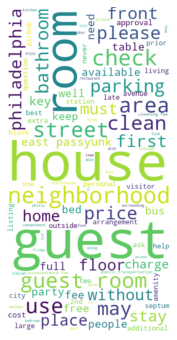

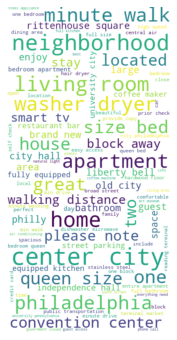

Garden or backyard


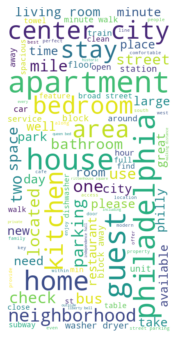

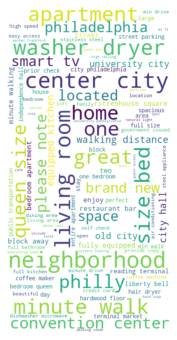

Gas oven
Not Available
Gym


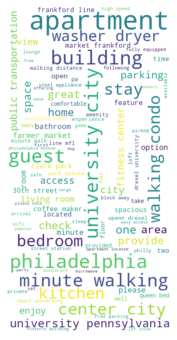

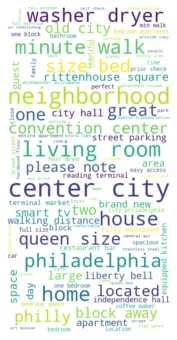

HBO GO
Not Available
Hair dryer


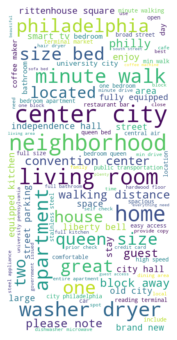

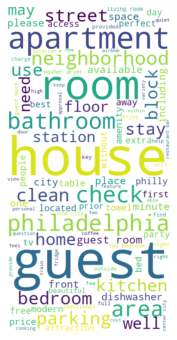

Hand Sanitiser


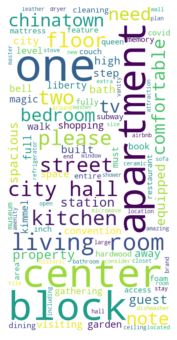

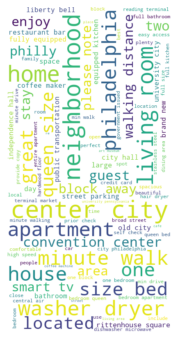

Handheld shower head
Not Available
Hangers


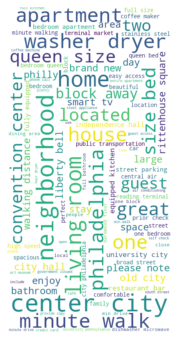

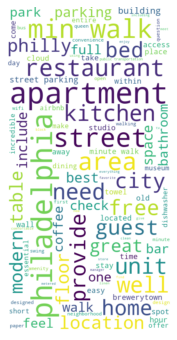

Heat lamps
Not Available
Heated floors
Not Available
Heating


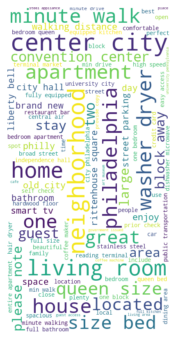

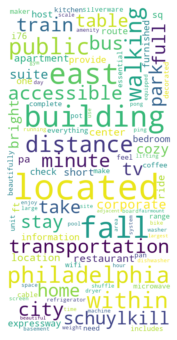

High chair


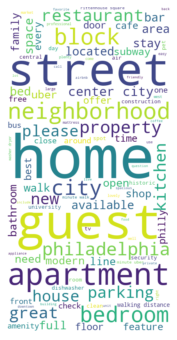

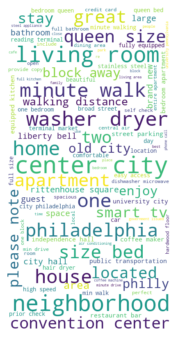

Host greets you
Not Available
Hot tub


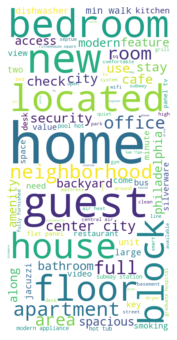

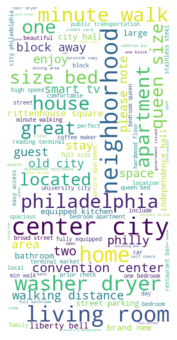

Hot water


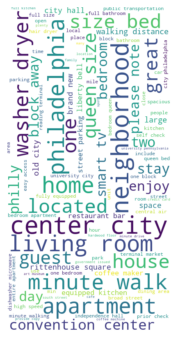

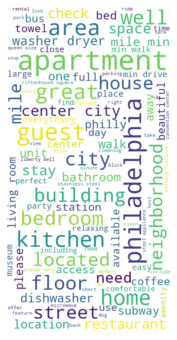

Hot water kettle


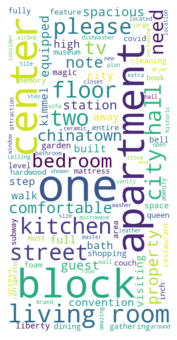

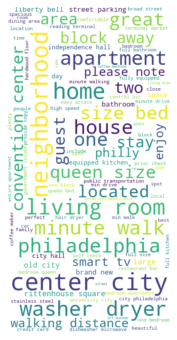

Indoor fireplace


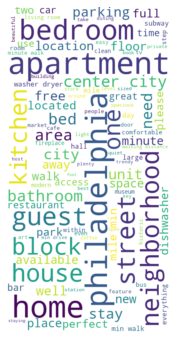

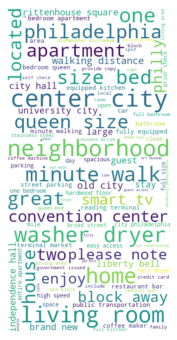

Internet


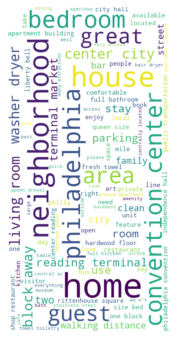

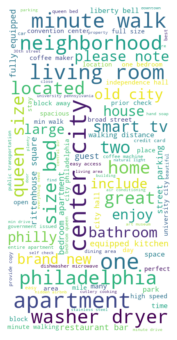

Iron


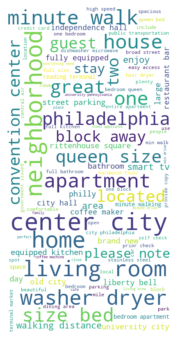

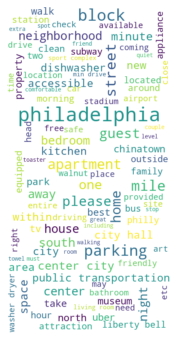

Jetted tub
Not Available
Keurig coffee machine


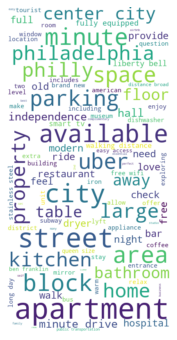

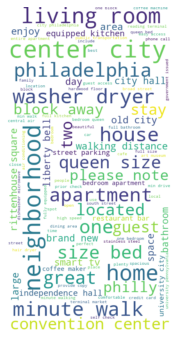

Keypad


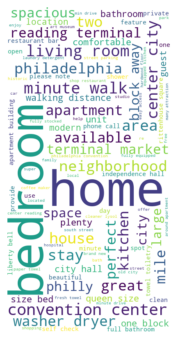

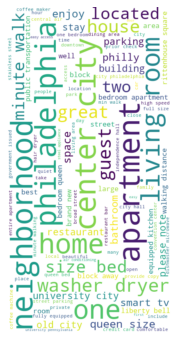

Kitchen


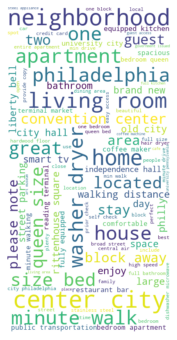

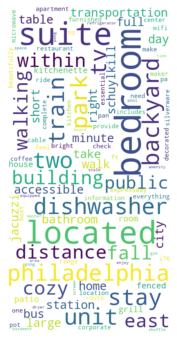

Kitchenette


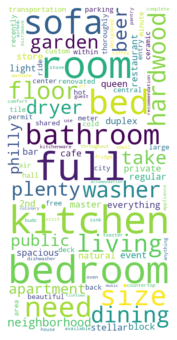

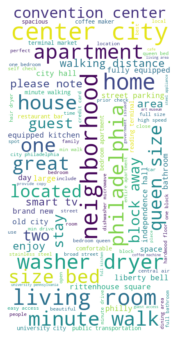

Laptop-friendly workspace


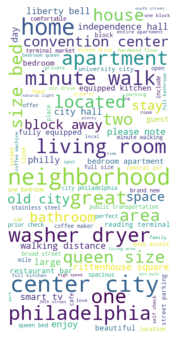

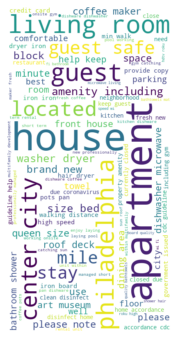

Laundromat nearby


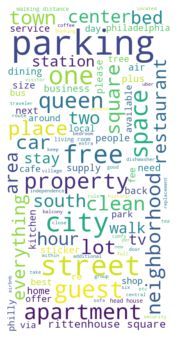

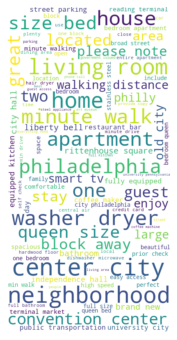

Lock on bedroom door


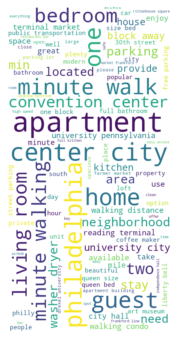

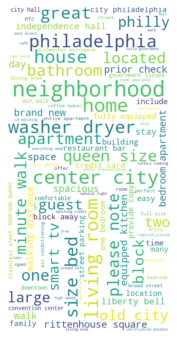

Lockbox


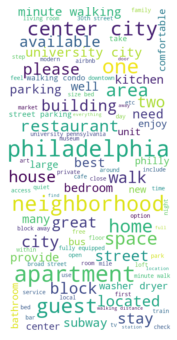

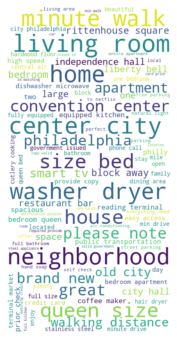

Long term stays allowed


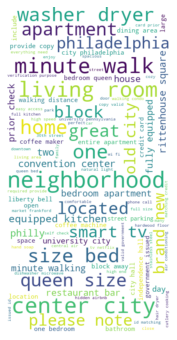

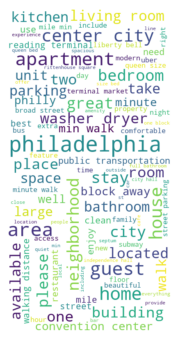

Luggage dropoff allowed


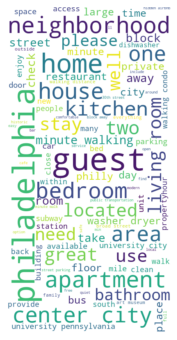

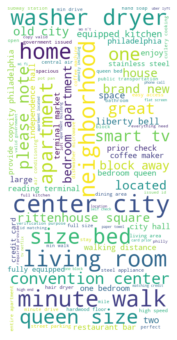

Memory foam mattress


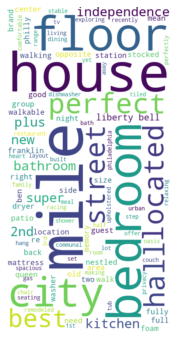

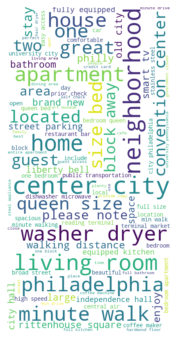

Microwave


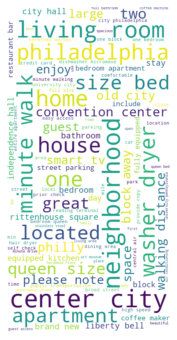

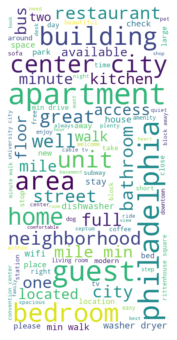

Mini fridge
Not Available
Mudroom
Not Available
Murphy bed
Not Available
Nespresso machine
Not Available
Netflix


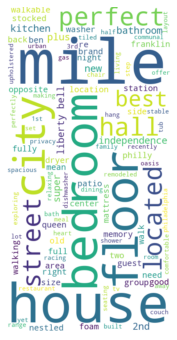

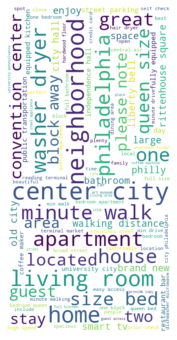

No stairs or steps to enter


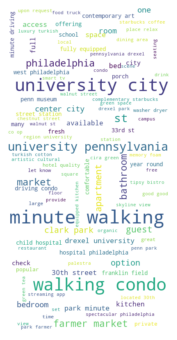

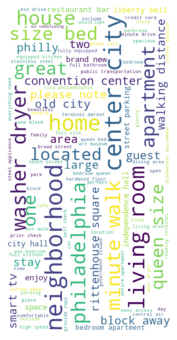

Other


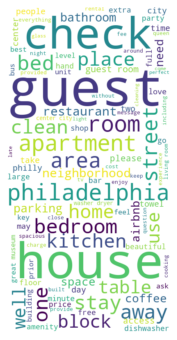

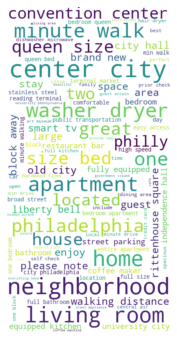

Other pet(s)
Not Available
Outdoor parking
Not Available
Outdoor seating
Not Available
Outlet covers


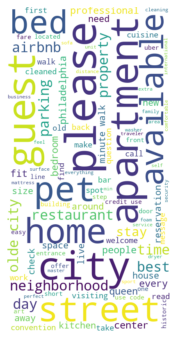

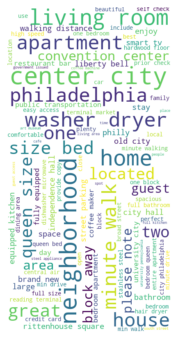

Oven


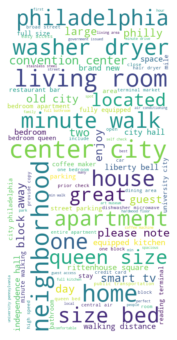

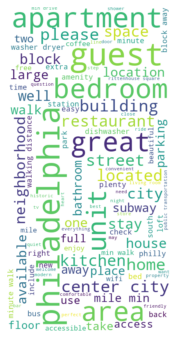

Pack ’n Play/travel crib


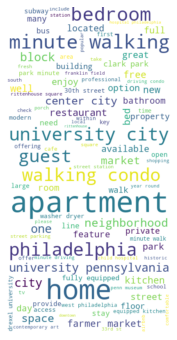

Not Available
Paid parking off premises


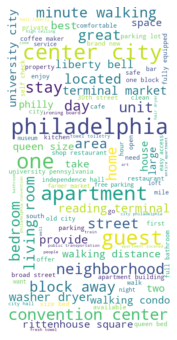

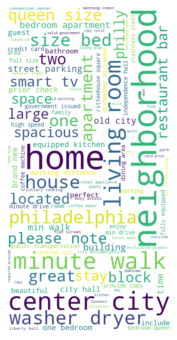

Paid parking on premises


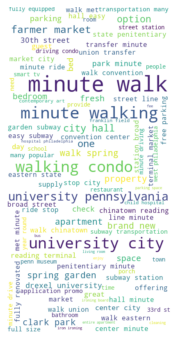

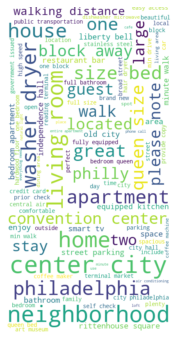

Patio or balcony


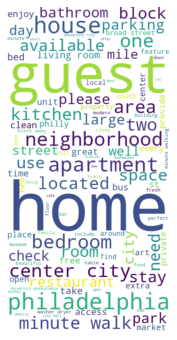

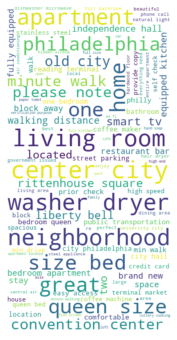

Pets allowed


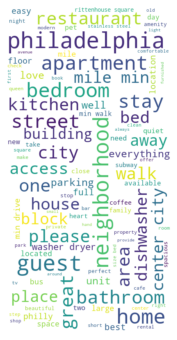

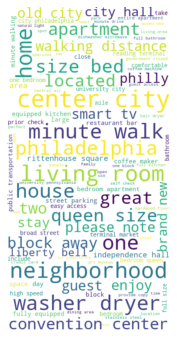

Pets live on this property


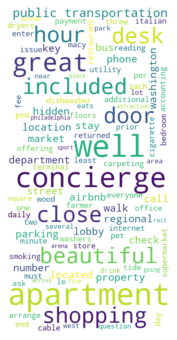

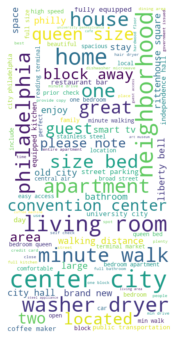

Piano
Not Available
Pillow-top mattress
Not Available
Playground
Not Available
Pocket wifi


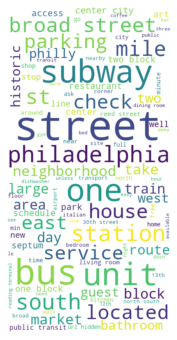

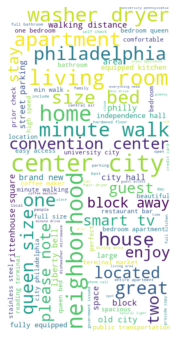

Pool


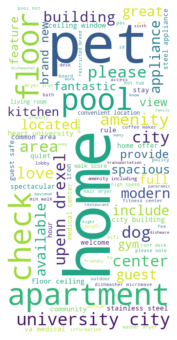

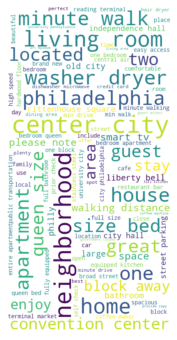

Portable fans


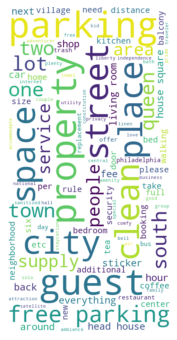

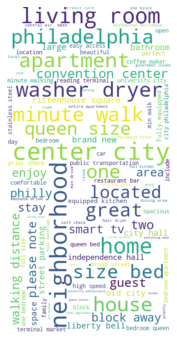

Pour Over Coffee


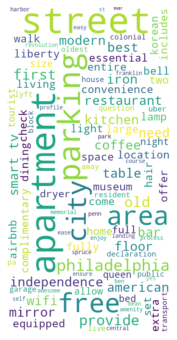

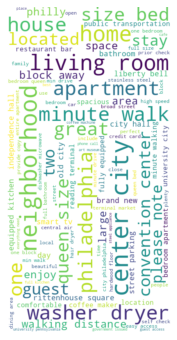

Printer
Not Available
Private entrance


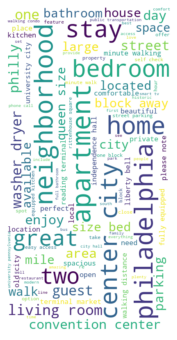

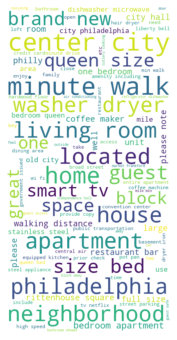

Private living room


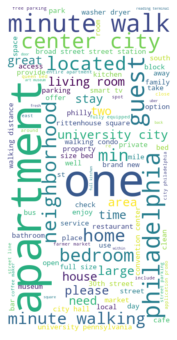

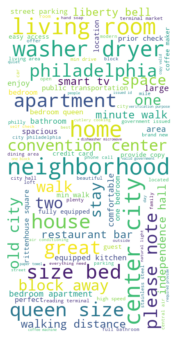

Rain shower
Not Available
Record player
Not Available
Refrigerator


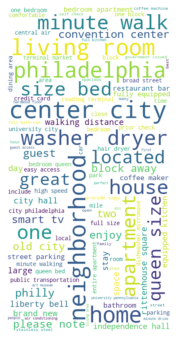

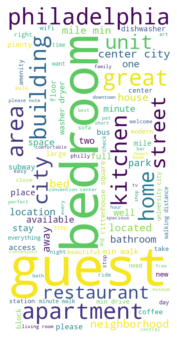

Rice Maker


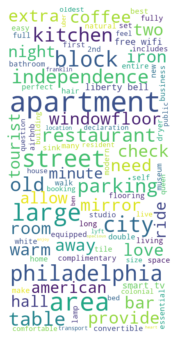

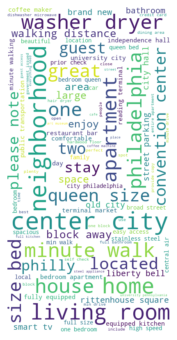

Roll-in shower
Not Available
Room-darkening shades


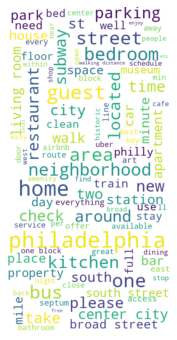

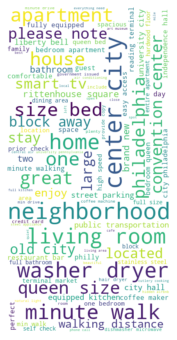

Safety card


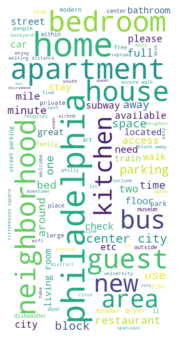

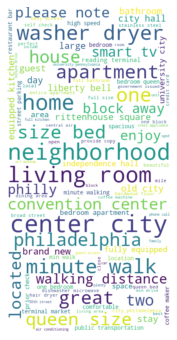

Self check-in


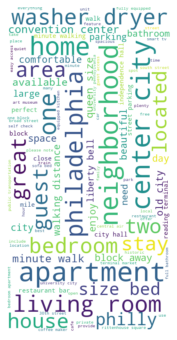

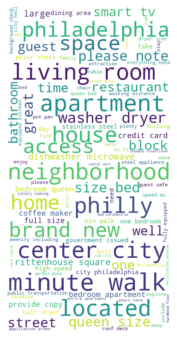

Shampoo


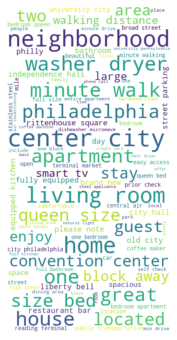

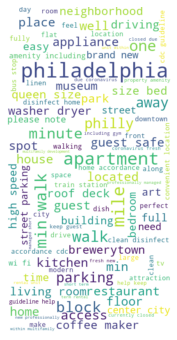

Shower gel


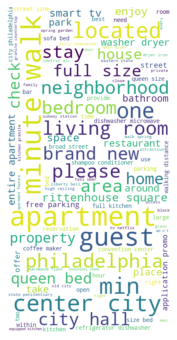

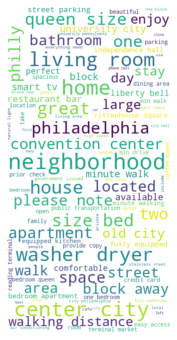

Single level home


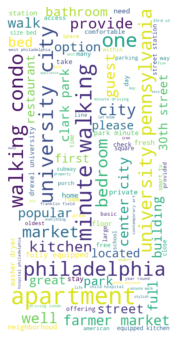

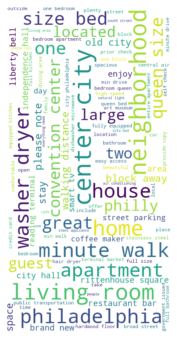

Smart TV


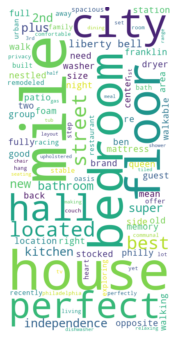

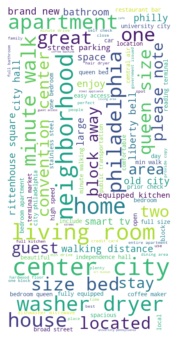

Smart lock


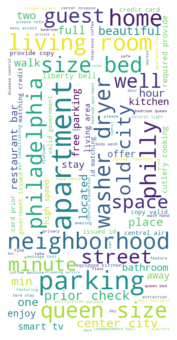

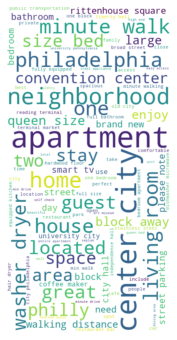

Smoke alarm


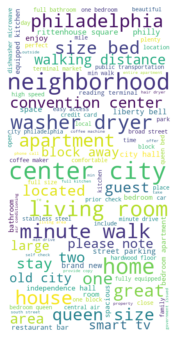

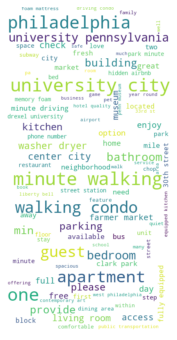

Smoke detector


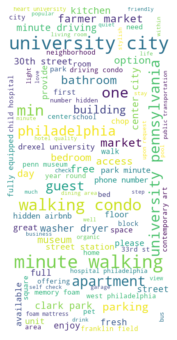

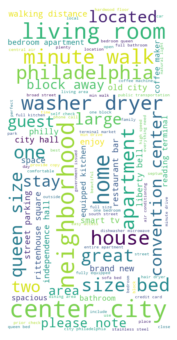

Smoking allowed


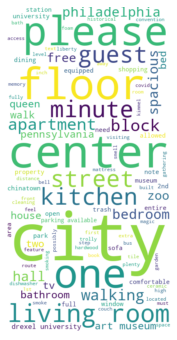

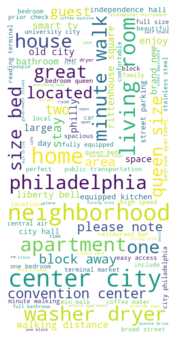

Soaking tub
Not Available
Sound system


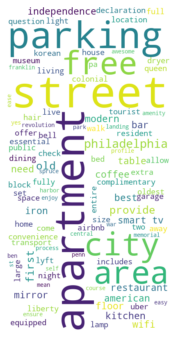

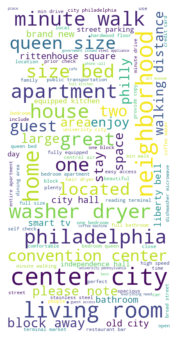

Stair gates


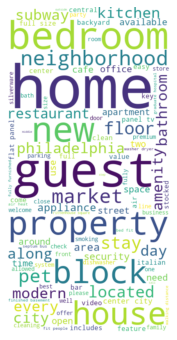

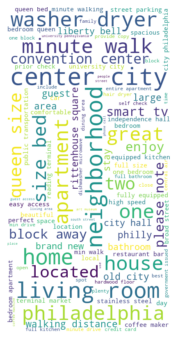

Stove


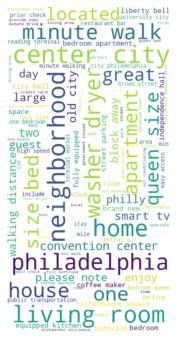

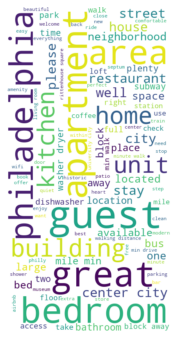

Suitable for events


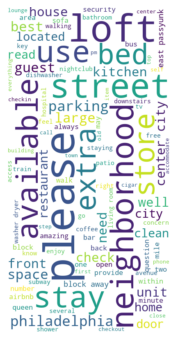

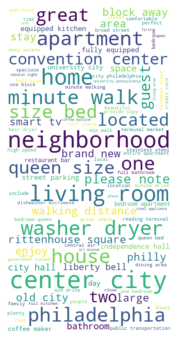

TV


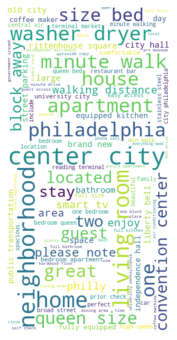

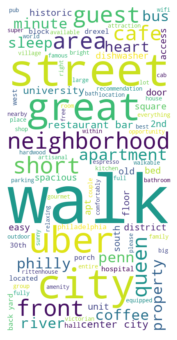

Table corner guards
Not Available
Terrace
Not Available
Toilet paper


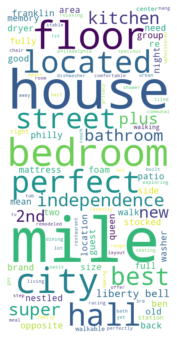

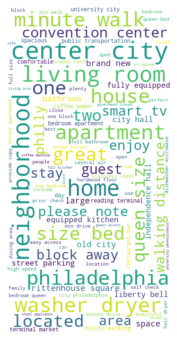

Trash can


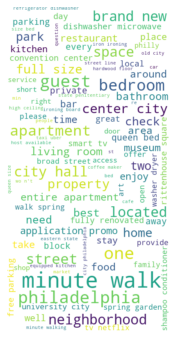

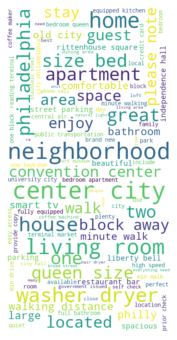

Trash compacter


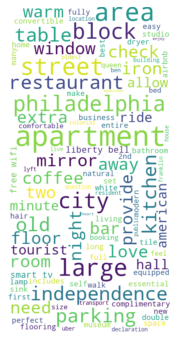

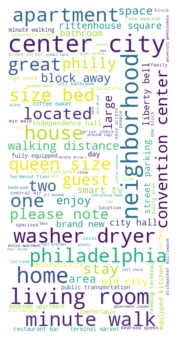

Walk-in shower
Not Available
Washer


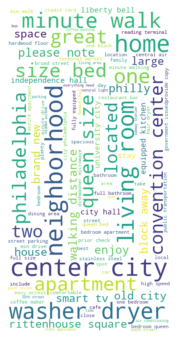

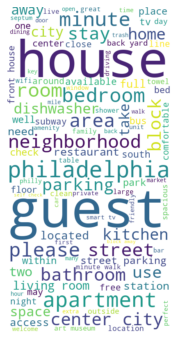

Waterfront
Not Available
Well-lit path to entrance


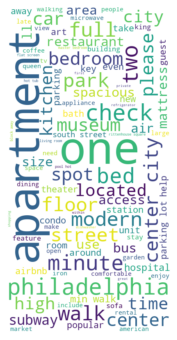

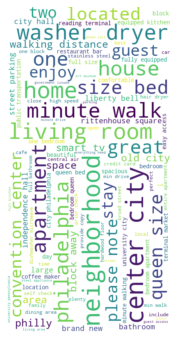

Wheelchair accessible


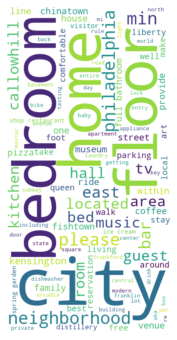

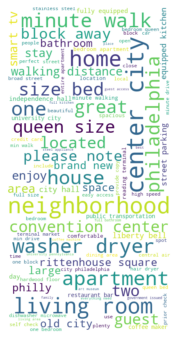

Wide clearance to shower
Not Available
Wide doorway to guest bathroom
Not Available
Wide entrance


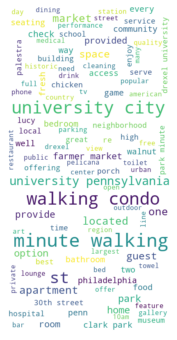

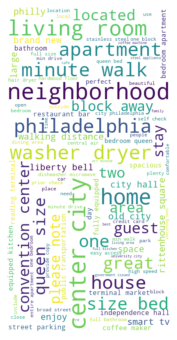

Wide entrance for guests


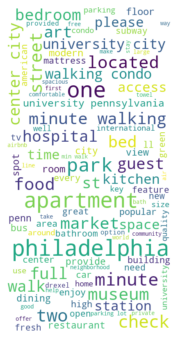

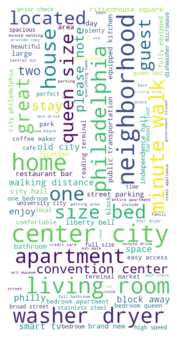

Wide entryway
Not Available
Wide hallways


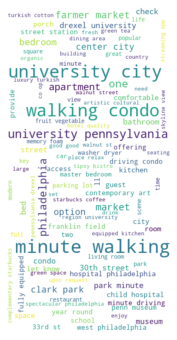

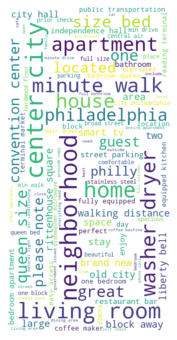

Wifi


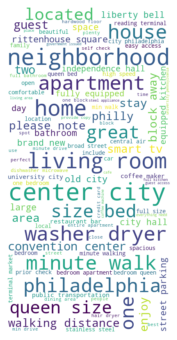

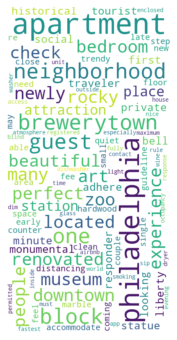

Window guards


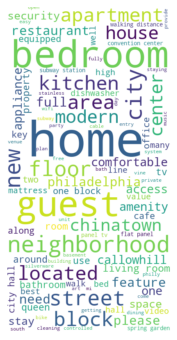

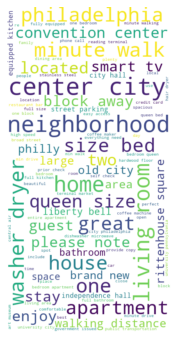

toilet
Not Available
translation missing: en.hosting_amenity_49


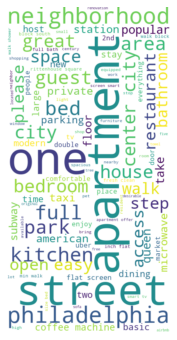

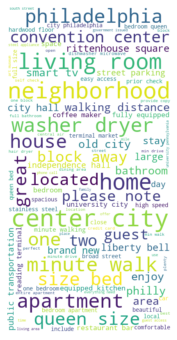

translation missing: en.hosting_amenity_50


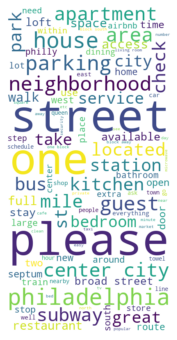

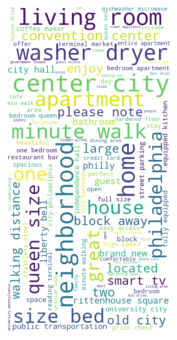

In [23]:
for i in am_names:
    try:
        print(i)
        am_descriptions = ' '.join(am_df[am_df[i]==1]['description']).lower()
        no_am_descriptions = ' '.join(am_df[am_df[i]==0]['description']).lower()
        am_tokens = extra_filter(corpus= am_descriptions, stop_tokens=extra_stopwords)
        no_am_tokens = extra_filter(corpus= no_am_descriptions, stop_tokens=extra_stopwords)
        wc = WordCloud(background_color="white", 
                       max_words=100, 
                       width=400, 
                       height=800,
                       collocations = True,
                       #collocation_threshold = 1
                      ).generate(' '.join(am_tokens))
        plt.figure(figsize=(12, 6))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis("off")
        plt.show()
        wc.to_file('static/' + i + '.png')
        wc = WordCloud(background_color="white", 
                       max_words=100, 
                       width=400, 
                       height=800,
                       collocations = True,
                       #collocation_threshold = 1
                      ).generate(' '.join(no_am_tokens))
        plt.figure(figsize=(12, 6))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis("off")
        plt.show()
        wc.to_file('Images/no_' + i + '.png')
    except:
        print("Not Available")
        continue

In [22]:
fdist_am = FreqDist(am_tokens)
fdist.most_common(50)

[('city', 4912),
 ('street', 3410),
 ('apartment', 3238),
 ('guest', 3216),
 ('center', 3074),
 ('philadelphia', 2970),
 ('parking', 2752),
 ('minute', 2501),
 ('walk', 2413),
 ('home', 2405),
 ('block', 2359),
 ('neighborhood', 2319),
 ("'s", 2305),
 ('bedroom', 2262),
 ('area', 2073),
 ('away', 2044),
 ('bed', 2024),
 ('kitchen', 2021),
 ('room', 1937),
 ('floor', 1918),
 ('please', 1904),
 ('also', 1904),
 ('house', 1860),
 ('restaurant', 1853),
 ('space', 1844),
 ('stay', 1814),
 ('located', 1781),
 ('one', 1772),
 ('available', 1723),
 ('access', 1688),
 ('2', 1571),
 ('building', 1475),
 ('need', 1428),
 ('full', 1411),
 ('bathroom', 1411),
 ('free', 1326),
 ('living', 1316),
 ('park', 1280),
 ('min', 1276),
 ('private', 1176),
 ('tv', 1174),
 ('bus', 1157),
 ('station', 1149),
 ('philly', 1144),
 ('unit', 1120),
 ('two', 1114),
 ('coffee', 1102),
 ('great', 1093),
 ('walking', 1090),
 ('place', 1065)]

In [23]:
# from io impot BytesIO
# imp = BytesIO()
# plt.savefig(img, format = 'png')


In [24]:
#print(dw_bi.items())

In [25]:
am_bigram = list(nltk.bigrams(am_tokens))
am_bi = FreqDist(am_bigram)

In [26]:
am_bi

FreqDist({('center', 'city'): 28, ('broad', 'street'): 19, ('one', 'block'): 12, ('living', 'room'): 11, ('30th', 'street'): 11, ('walking', 'distance'): 10, ('south', 'street'): 10, ('public', 'transit'): 10, ('street', 'station'): 10, ('bus', 'subway'): 9, ...})

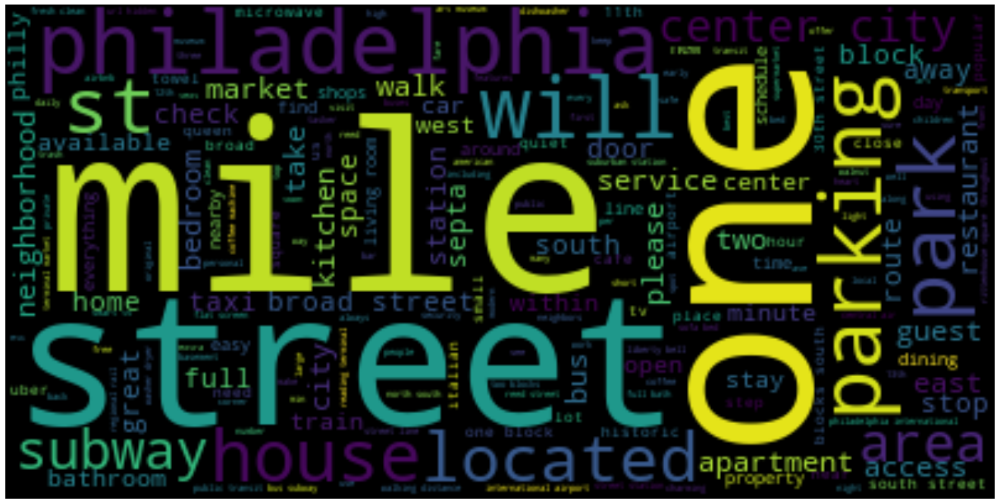

In [27]:
wc = WordCloud()
#wc.generate_from_frequencies(am_bi)
wc.generate(am_descriptions)
import matplotlib.pyplot as plt
%matplotlib inline
# show
plt.figure(figsize=(24, 12))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

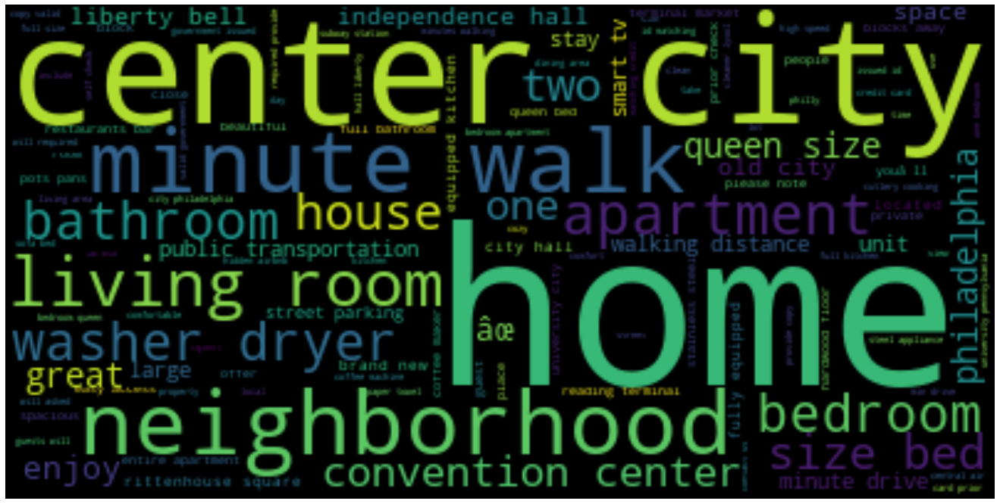

In [28]:
wc = WordCloud()
#wc.generate_from_frequencies(am_bi)
wc.generate(no_am_descriptions)
import matplotlib.pyplot as plt
%matplotlib inline
# show
plt.figure(figsize=(24, 12))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [29]:
fdist_am.most_common(50)

[('street', 111),
 ('one', 58),
 ('mile', 55),
 ('block', 53),
 ('city', 50),
 ('center', 50),
 ('bus', 47),
 ('philadelphia', 46),
 ('station', 44),
 ('house', 43),
 ('parking', 41),
 ('apartment', 39),
 ('south', 37),
 ('restaurant', 35),
 ('subway', 35),
 ('also', 35),
 ('bed', 34),
 ('â', 34),
 ('two', 32),
 ('kitchen', 32),
 ('market', 31),
 ('walk', 31),
 ('park', 30),
 ('broad', 30),
 ('take', 28),
 ('located', 28),
 ('2', 28),
 ('area', 27),
 ('guest', 26),
 ('neighborhood', 25),
 ('full', 25),
 ('access', 25),
 ('line', 25),
 ("'s", 24),
 ('bedroom', 24),
 ('please', 24),
 ('coffee', 23),
 ('stop', 23),
 ('service', 22),
 ('square', 22),
 ('room', 22),
 ('minute', 22),
 ('home', 20),
 ('queen', 20),
 ('floor', 20),
 ('day', 19),
 ('check', 19),
 ('within', 18),
 ('away', 18),
 ('uber', 18)]

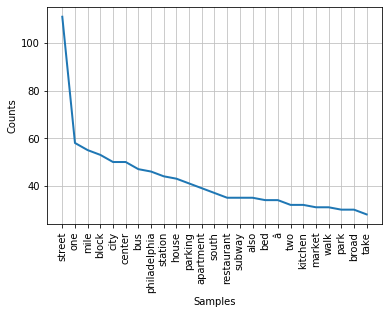

In [30]:
fdist_am.plot(25)

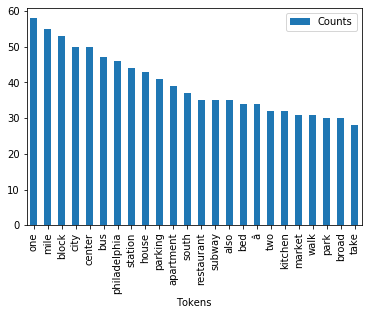

In [31]:
#Removing "apartment" Below
pd.DataFrame(fdist_am.most_common(25)[1:], columns=['Tokens', 'Counts']).set_index('Tokens').plot(kind='bar')

In [32]:
rev_groups = df.groupby('Dishwasher')

In [33]:
#next let's build a function that we can apply aggregated to our groups

def freq_analysis(txt, stop_tokens=extra_stopwords, num =25):
    txt = ' '.join(txt.fillna(''))
    txt = txt.lower()
    stop_filters = stopwords.words('english') + list(string.punctuation) + stop_tokens
    filtered_tokens = [tokens for tokens in word_tokenize(txt) 
                       if tokens not in stop_filters]
    rev_bigram = list(nltk.bigrams(filtered_tokens))
    
    #return rev_bigram
    fdist = FreqDist(rev_bigram)
    return fdist.most_common(num)

In [34]:
rev_top50 = rev_groups.agg({'description' : freq_analysis})

In [35]:
pd.set_option('display.max_colwidth', None)
rev_top50

,description
Dishwasher,
0,"[((center, city), 750), ((walking, distance), 333), ((street, parking), 289), ((living, room), 243), ((public, transportation), 237), ((â€, ”), 233), ((blocks, away), 230), ((hidden, airbnb), 176), ((minute, walk), 154), ((university, city), 153), ((smart, tv), 153), ((convention, center), 149), ((rittenhouse, square), 145), ((size, bed), 130), ((ä, »), 126), ((city, hall), 125), ((phone, number), 124), ((old, city), 120), ((washer, dryer), 120), ((block, away), 119), ((number, hidden), 119), ((liberty, bell), 117), ((broad, street), 117), ((brand, new), 116), ((south, street), 115)]"
1,"[((center, city), 1084), ((living, room), 536), ((street, parking), 427), ((minute, walk), 379), ((walking, distance), 369), ((rittenhouse, square), 358), ((old, city), 351), ((convention, center), 327), ((public, transportation), 308), ((washer, dryer), 298), ((fully, equipped), 282), ((liberty, bell), 281), ((â€, ”), 255), ((art, museum), 249), ((brand, new), 246), ((blocks, away), 244), ((restaurants, bars), 241), ((independence, hall), 235), ((smart, tv), 219), ((easy, access), 218), ((city, hall), 217), ((equipped, kitchen), 217), ((city, philadelphia), 213), ((hidden, airbnb), 212), ((entire, apartment), 205)]"


In [36]:
amenity_text = nltk.Text(corpus.split())

In [12]:
amenity_text.concordance('dishwasher', width = 500)

NameError: name 'amenity_text' is not defined

In [38]:
amenity_text.common_contexts(['renovated', 'studio'])

beautiful_apartment


In [39]:
df_nlp_am = am_df
sample_size = 10000

def sentiment_func(x):
    sentiment = TextBlob(x['description'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

am_nlp = df_nlp_am.apply(sentiment_func, axis=1)

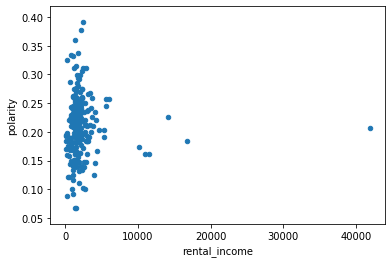

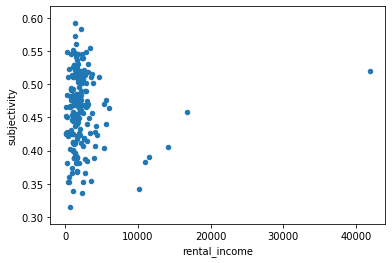

In [40]:
am_nlp.plot.scatter('rental_income', 'polarity')
am_nlp.plot.scatter('rental_income', 'subjectivity')

In [41]:
#Sample Stuff Below

In [42]:
X_train_text = df_text[df_text.index.isin(list(X_train.index.values))]
X_test_text = df_text[df_text.index.isin(list(X_test.index.values))]

NameError: name 'df_text' is not defined

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
count_vec = CountVectorizer(ngram_range=(1,10), min_df=2)
X_train_count = count_vec.fit_transform(X_train_text.name)
X_train_count

- Not sure
- Get number of feature names (tokens)
- Print out token every 100 words

In [ ]:
import numpy as np
print(np.sum(X_train_count.todense()[0]))
print(len(count_vec.get_feature_names()))
print(count_vec.get_feature_names()[::10])

In [ ]:
import dill
dill.dump_session('notebook_env.db')